## Single Object

Here we fit a single object from our gold sample of best-observed asteroids with 
different fitting configurations and assumptions on priors. 

This notebook serves as a template for running several fits on a single object. 

In [1]:
# Repository locations
ATM_DATA_DIR = "/epyc/projects/atm/atm_data/"

from atm import __version__
print("ATM Version: {}".format(__version__))

ATM Version: 1.0


In [2]:
import numpy as np
import pandas as pd
import sqlite3 as sql
import matplotlib.pyplot as plt
import warnings

%matplotlib inline

from atm import modifyErrors
from atm import multiFit
from atm.models import NEATM
from atm.obs import WISE
from atm.analysis import calcMagChi2
from atm.analysis import calcMagReducedChi2
from atm.functions import calcFluxLambdaSED
from atm.plotting import plotObservations
from atm.plotting import plotSED

In [2]:
m_to_mum = 1e6 # simple conversion from m to micron
km_to_m = 1e3 # conversion km to m

In [3]:
DPI = 600
SAVE_DIR = "../plots/"
FORMAT = "png"

SAVE_FIGS = False

In [4]:
# Grab observations and additional data
con = sql.connect("../../data/sample.db")
observations = pd.read_sql("""SELECT * FROM observations""", con)
additional = pd.read_sql("""SELECT * FROM additional""", con)

# Only keep clipped observations
observations = observations[observations["keep"] == 1]
additional = additional[additional["obs_id"].isin(observations["obs_id"].values)]

# Remove missing H value, G value objects... 
observations = observations[~observations["designation"].isin(['2010 AJ104', '2010 BM69', '2010 DZ64', '2010 EL27', '2010 EW144',
   '2010 FE82', '2010 FJ48', '2010 HK10', '2010 LE80'])]

# Convert phase angle to radians
observations["alpha_rad"] = np.radians(observations["alpha_deg"])
ran_override = False

# Initialize observatory 
obs = WISE()

In [5]:
if ran_override == False:
    observations = modifyErrors(observations, obs, sigma=0.15)
    ran_override = True
else:
    print("No need to run this again!")

Added 0.15 magnitude errors to magErr_W1.
Added 0.15 magnitude errors to magErr_W2.
Added 0.15 magnitude errors to magErr_W3.
Added 0.15 magnitude errors to magErr_W4.
Converted magnitude errors to flux errors.
Updating fluxErr_W1_si with new error.
Updating fluxErr_W2_si with new error.
Updating fluxErr_W3_si with new error.
Updating fluxErr_W4_si with new error.
Done.



## Select asteroid and set sampling configuration

In [6]:
asteroid_name = "1719"

In [7]:
runDict = {}
dataDict = {}

fitConfig = {
        "chains" : 20,
        "samples" : 3000,
        "burnInSamples": 500,
        "threads": 20,
        "scaling": 0.01,
        "plotTrace" : True,
        "plotCorner" : True,
        "progressBar" : True,
        "figKwargs" : {"dpi" : DPI}
    }

data = observations[observations["designation"].isin([asteroid_name])]
data_additional = additional[additional["obs_id"].isin(data["obs_id"].values)] # Contains published magnitudes

In [8]:
data.head()

,obs_id,designation,r_au,delta_au,alpha_deg,H_mag,G,mjd,flux_W1_si,fluxErr_W1_si,...,mag_W1,magErr_W1,mag_W2,magErr_W2,mag_W3,magErr_W3,mag_W4,magErr_W4,keep,alpha_rad
19996,19997,1719,2.468516,2.168062,23.5845,11.7,0.15,55262.210109,1.303661e-10,2.881720e-11,...,14.484,0.240,12.014,0.192,4.953,0.164,2.586,0.177,1,0.411627
19997,19998,1719,2.469142,2.171959,23.5879,11.7,0.15,55262.474717,2.232363e-10,4.214969e-11,...,13.900,0.205,12.014,0.195,5.033,0.161,2.591,0.165,1,0.411687
19998,19999,1719,2.469926,2.176834,23.5918,11.7,0.15,55262.805540,1.527442e-10,3.390452e-11,...,14.312,0.241,12.061,0.212,4.865,0.163,2.414,0.172,1,0.411755
20000,20001,1719,2.470239,2.178784,23.5932,11.7,0.15,55262.937844,1.400764e-10,3.109264e-11,...,14.406,0.241,11.908,0.187,4.931,0.168,2.588,0.184,1,0.411779
20001,20002,1719,2.470396,2.179761,23.5939,11.7,0.15,55263.004060,6.047346e-11,2.027411e-11,...,15.318,0.364,12.449,0.212,5.466,0.164,3.047,0.194,1,0.411791


In [9]:
data_additional.head()

,obs_id,ra_deg,ra_sigma_arcsec,ra_u,dec_deg,dec_sigma_arcsec,dec_u,radec_cosigma_arcsec,w1mpro,w1rchi2,...,w4sigmpro,w4snr,cc_flags,cntr_u,dist_x,pang_x,ph_qual,na,nb,sso_flg
19996,19997,80.453202,0.0727,80.453190,33.264070,0.0853,33.264070,-0.0251,14.484,0.5029,...,0.027,40.5,0000,1,0.035549,87.678448,AAAA,0,1,1
19997,19998,80.531641,0.0509,80.531623,33.237586,0.0632,33.237528,0.0074,13.900,9.8600,...,0.015,70.4,0000,3,0.217189,14.532789,AAAA,0,2,1
19998,19999,80.630142,0.0652,80.630086,33.204466,0.0774,33.204436,-0.0284,14.312,0.5401,...,0.022,49.2,0000,6,0.199840,57.898193,AAAA,0,1,1
20000,20001,80.669628,0.0949,80.669589,33.191263,0.0966,33.191236,0.0282,14.406,1.3080,...,0.034,31.5,0000,9,0.153641,50.057553,AAAA,0,1,1
20001,20002,80.689364,0.0820,80.689386,33.184619,0.0867,33.184628,-0.0206,15.318,0.6542,...,0.044,24.6,0000,10,0.073990,-116.903709,BAAA,0,1,1


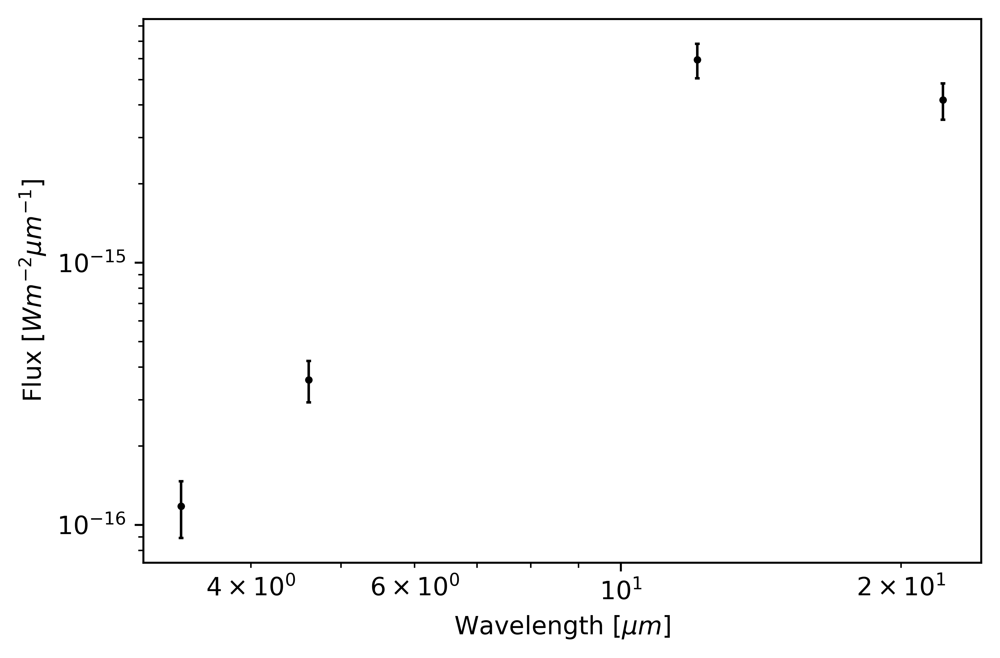

In [10]:
fig, ax = plt.subplots(1, 1, dpi=DPI)
plotObservations(obs, data, ax=ax, plotMedian=True)

## Run 0 - Constant Emissivity
Fit Parameters: [logD, logT1, eps]  
fitFilters = "all"

In [11]:
dataDict["run0"] = data.copy()

runDict["run0"] = {
    "fitParameters" : ["logT1", "logD", "eps"],
    "emissivitySpecification" : None,
    "albedoSpecification": "auto",
    "fitFilters" : "all",
    "columnMapping" : {
                "obs_id" : "obs_id",
                "designation" : "designation",
                "exp_mjd" : "mjd",
                "r_au" : "r_au",
                "delta_au" : "delta_au",
                "alpha_rad" : "alpha_rad",
                "eps" : None,
                "p" : None,
                "G" : "G",
                "logT1" : None,
                "logD" : None,
                "flux_si" : ["flux_W1_si", "flux_W2_si", "flux_W3_si", "flux_W4_si"],
                "fluxErr_si" : ["fluxErr_W1_si", "fluxErr_W2_si", "fluxErr_W3_si", "fluxErr_W4_si"],  
                "mag" : ["mag_W1", "mag_W2", "mag_W3", "mag_W4"],
                "magErr" : ["magErr_W1", "magErr_W2", "magErr_W3", "magErr_W4"]
    }
}

## Run 1 - 3 Parameters
Fit Parameters: [logD, logT1, eps_W1W2]  
fitFilters = "all"  
eps_W3 = 0.9  
eps_W4 = 0.9

In [12]:
dataDict["run1"] = data.copy()
dataDict["run1"]["eps_W3W4"] = np.ones(len(data)) * 0.9

runDict["run1"] = {
    "fitParameters" : ["logT1", "logD", "eps_W1W2"],
    "emissivitySpecification" : {
                "eps_W1W2" : ["W1","W2"],
                "eps_W3W4" : ["W3","W4"]},
    "albedoSpecification": "auto",
    "fitFilters" : "all",
    "columnMapping" : {
                "obs_id" : "obs_id",
                "designation" : "designation",
                "exp_mjd" : "mjd",
                "r_au" : "r_au",
                "delta_au" : "delta_au",
                "alpha_rad" : "alpha_rad",
                "eps" : ["eps_W3W4"],
                "p" : None,
                "G" : "G",
                "logT1" : None,
                "logD" : None,
                "flux_si" : ["flux_W1_si", "flux_W2_si", "flux_W3_si", "flux_W4_si"],
                "fluxErr_si" : ["fluxErr_W1_si", "fluxErr_W2_si", "fluxErr_W3_si", "fluxErr_W4_si"],
                "mag" : ["mag_W1", "mag_W2", "mag_W3", "mag_W4"],
                "magErr" : ["magErr_W1", "magErr_W2", "magErr_W3", "magErr_W4"]
    }
}

## Run 2a - Track 1, 3 parameters
Fit Parameters: [logD, logT1, eps_W1W2]  
eps_W3 = 0.70  
eps_W4 = 0.86  
fitFilters = "all"  

In [13]:
dataDict["run2a"] = data.copy()
dataDict["run2a"]["eps_W3"] = np.ones(len(data)) * 0.70
dataDict["run2a"]["eps_W4"] = np.ones(len(data)) * 0.86

runDict["run2a"] = {
    "fitParameters" : ["logT1", "logD", "eps_W1W2"],
    "emissivitySpecification" : {
                "eps_W1W2" : ["W1","W2"],
                "eps_W3" : ["W3"],
                "eps_W4" : ["W4"]},
    "albedoSpecification": "auto",
    "fitFilters" : "all",
    "columnMapping" : {
                "obs_id" : "obs_id",
                "designation" : "designation",
                "exp_mjd" : "mjd",
                "r_au" : "r_au",
                "delta_au" : "delta_au",
                "alpha_rad" : "alpha_rad",
                "eps" : ["eps_W3", "eps_W4"],
                "p" : None,
                "G" : "G",
                "logT1" : None,
                "logD" : None,
                "flux_si" : ["flux_W1_si", "flux_W2_si", "flux_W3_si", "flux_W4_si"],
                "fluxErr_si" : ["fluxErr_W1_si", "fluxErr_W2_si", "fluxErr_W3_si", "fluxErr_W4_si"],
                "mag" : ["mag_W1", "mag_W2", "mag_W3", "mag_W4"],
                "magErr" : ["magErr_W1", "magErr_W2", "magErr_W3", "magErr_W4"]
    }
}

## Run 2b - Track 1, 4 parameters
Fit Parameters: [logD, logT1, eps_W1, eps_W2]  
eps_W3 = 0.70  
eps_W4 = 0.86  
fitFilters = "all"  

In [14]:
dataDict["run2b"] = data.copy()
dataDict["run2b"]["eps_W3"] = np.ones(len(data)) * 0.70
dataDict["run2b"]["eps_W4"] = np.ones(len(data)) * 0.86

runDict["run2b"] = {
    "fitParameters" : ["logT1", "logD", "eps_W1", "eps_W2"],
    "emissivitySpecification" : "perBand",
    "albedoSpecification": "auto",
    "fitFilters" : "all",
    "columnMapping" : {
                "obs_id" : "obs_id",
                "designation" : "designation",
                "exp_mjd" : "mjd",
                "r_au" : "r_au",
                "delta_au" : "delta_au",
                "alpha_rad" : "alpha_rad",
                "eps" : ["eps_W3", "eps_W4"],
                "p" : None,
                "G" : "G",
                "logT1" : None,
                "logD" : None,
                "flux_si" : ["flux_W1_si", "flux_W2_si", "flux_W3_si", "flux_W4_si"],
                "fluxErr_si" : ["fluxErr_W1_si", "fluxErr_W2_si", "fluxErr_W3_si", "fluxErr_W4_si"],  
                "mag" : ["mag_W1", "mag_W2", "mag_W3", "mag_W4"],
                "magErr" : ["magErr_W1", "magErr_W2", "magErr_W3", "magErr_W4"]
    }
}

## Run 3a - Track 2, 3 parameters
Fit Parameters: [logD, logT1, eps_W1W2]  
eps_W3 = 0.76  
eps_W4 = 0.93  
fitFilters = "all"  

In [15]:
dataDict["run3a"] = data.copy()
dataDict["run3a"]["eps_W3"] = np.ones(len(data)) * 0.76
dataDict["run3a"]["eps_W4"] = np.ones(len(data)) * 0.93

runDict["run3a"] = {
    "fitParameters" : ["logT1", "logD", "eps_W1W2"],
    "emissivitySpecification" : {
                "eps_W1W2" : ["W1","W2"],
                "eps_W3" : ["W3"],
                "eps_W4" : ["W4"]},
    "albedoSpecification": "auto",
    "fitFilters" : "all",
    "columnMapping" : {
                "obs_id" : "obs_id",
                "designation" : "designation",
                "exp_mjd" : "mjd",
                "r_au" : "r_au",
                "delta_au" : "delta_au",
                "alpha_rad" : "alpha_rad",
                "eps" : ["eps_W3", "eps_W4"],
                "p" : None,
                "G" : "G",
                "logT1" : None,
                "logD" : None,
                "flux_si" : ["flux_W1_si", "flux_W2_si", "flux_W3_si", "flux_W4_si"],
                "fluxErr_si" : ["fluxErr_W1_si", "fluxErr_W2_si", "fluxErr_W3_si", "fluxErr_W4_si"],  
                "mag" : ["mag_W1", "mag_W2", "mag_W3", "mag_W4"],
                "magErr" : ["magErr_W1", "magErr_W2", "magErr_W3", "magErr_W4"]
    }
}

## Run 3b - Track 2, 4 parameters
Fit Parameters: [logD, logT1, eps_W1, eps_W2]  
eps_W3 = 0.76  
eps_W4 = 0.93  
fitFilters = "all"  

In [16]:
dataDict["run3b"] = data.copy()
dataDict["run3b"]["eps_W3"] = np.ones(len(data)) * 0.76
dataDict["run3b"]["eps_W4"] = np.ones(len(data)) * 0.93

runDict["run3b"] = {
    "fitParameters" : ["logT1", "logD", "eps_W1", "eps_W2"],
    "emissivitySpecification" : "perBand",
    "albedoSpecification": "auto",
    "fitFilters" : "all",
    "columnMapping" : {
                "obs_id" : "obs_id",
                "designation" : "designation",
                "exp_mjd" : "mjd",
                "r_au" : "r_au",
                "delta_au" : "delta_au",
                "alpha_rad" : "alpha_rad",
                "eps" : ["eps_W3", "eps_W4"],
                "p" : None,
                "G" : "G",
                "logT1" : None,
                "logD" : None,
                "flux_si" : ["flux_W1_si", "flux_W2_si", "flux_W3_si", "flux_W4_si"],
                "fluxErr_si" : ["fluxErr_W1_si", "fluxErr_W2_si", "fluxErr_W3_si", "fluxErr_W4_si"],  
                "mag" : ["mag_W1", "mag_W2", "mag_W3", "mag_W4"],
                "magErr" : ["magErr_W1", "magErr_W2", "magErr_W3", "magErr_W4"]
    }
}

## Run 4a - Track 3, 3 parameters
Fit Parameters: [logD, logT1, eps_W1W2]  
eps_W3 = 0.80  
eps_W4 = 0.98  
fitFilters = "all"  

In [17]:
dataDict["run4a"] = data.copy()
dataDict["run4a"]["eps_W3"] = np.ones(len(data)) * 0.80
dataDict["run4a"]["eps_W4"] = np.ones(len(data)) * 0.98

runDict["run4a"] = {
    "fitParameters" : ["logT1", "logD", "eps_W1W2"],
    "emissivitySpecification" : {
                "eps_W1W2" : ["W1","W2"],
                "eps_W3" : ["W3"],
                "eps_W4" : ["W4"]},
    "albedoSpecification": "auto",
    "fitFilters" : "all",
    "columnMapping" : {
                "obs_id" : "obs_id",
                "designation" : "designation",
                "exp_mjd" : "mjd",
                "r_au" : "r_au",
                "delta_au" : "delta_au",
                "alpha_rad" : "alpha_rad",
                "eps" : ["eps_W3", "eps_W4"],
                "p" : None,
                "G" : "G",
                "logT1" : None,
                "logD" : None,
                "flux_si" : ["flux_W1_si", "flux_W2_si", "flux_W3_si", "flux_W4_si"],
                "fluxErr_si" : ["fluxErr_W1_si", "fluxErr_W2_si", "fluxErr_W3_si", "fluxErr_W4_si"],  
                "mag" : ["mag_W1", "mag_W2", "mag_W3", "mag_W4"],
                "magErr" : ["magErr_W1", "magErr_W2", "magErr_W3", "magErr_W4"]
    }
}

## Run 4b - Track 3, 4 parameters
Fit Parameters: [logD, logT1, eps_W1, eps_W2]  
eps_W3 = 0.80  
eps_W4 = 0.98  
fitFilters = "all"  

In [18]:
dataDict["run4b"] = data.copy()
dataDict["run4b"]["eps_W3"] = np.ones(len(data)) * 0.80
dataDict["run4b"]["eps_W4"] = np.ones(len(data)) * 0.98

runDict["run4b"] = {
    "fitParameters" : ["logT1", "logD", "eps_W1", "eps_W2"],
    "emissivitySpecification" : "perBand",
    "albedoSpecification": "auto",
    "fitFilters" : "all",
    "columnMapping" : {
                "obs_id" : "obs_id",
                "designation" : "designation",
                "exp_mjd" : "mjd",
                "r_au" : "r_au",
                "delta_au" : "delta_au",
                "alpha_rad" : "alpha_rad",
                "eps" : ["eps_W3", "eps_W4"],
                "p" : None,
                "G" : "G",
                "logT1" : None,
                "logD" : None,
                "flux_si" : ["flux_W1_si", "flux_W2_si", "flux_W3_si", "flux_W4_si"],
                "fluxErr_si" : ["fluxErr_W1_si", "fluxErr_W2_si", "fluxErr_W3_si", "fluxErr_W4_si"],  
                "mag" : ["mag_W1", "mag_W2", "mag_W3", "mag_W4"],
                "magErr" : ["magErr_W1", "magErr_W2", "magErr_W3", "magErr_W4"]
    }
}

## Run 5a - NEOWISE
Fit Parameters: [logD, logT1, p_W1W2]  
eps_W1 = 0.9  
eps_W2 = 0.9  
eps_W3 = 0.9  
eps_W4 = 0.9  
p_W3 = 0.0  
p_W4 = 0.0   
fitFilters = "all"    

In [19]:
dataDict["run5a"] = data.copy()
dataDict["run5a"]["eps"] = np.ones(len(data)) * 0.9
dataDict["run5a"]["p_W3"] = np.ones(len(data)) * 0.0
dataDict["run5a"]["p_W4"] = np.ones(len(data)) * 0.0

runDict["run5a"] = {
    "fitParameters" : ["logT1", "logD", "p_W1W2"],
    "emissivitySpecification" : None,
    "albedoSpecification": {
                "p_W1W2" : ["W1", "W2"],
                "p_W3" : ["W3"],
                "p_W4" : ["W4"]},
    "fitFilters" : "all",
    "columnMapping" : {
                "obs_id" : "obs_id",
                "designation" : "designation",
                "exp_mjd" : "mjd",
                "r_au" : "r_au",
                "delta_au" : "delta_au",
                "alpha_rad" : "alpha_rad",
                "eps" : "eps",
                "p" : ["p_W3", "p_W4"],
                "G" : "G",
                "logT1" : None,
                "logD" : None,
                "flux_si" : ["flux_W1_si", "flux_W2_si", "flux_W3_si", "flux_W4_si"],
                "fluxErr_si" : ["fluxErr_W1_si", "fluxErr_W2_si", "fluxErr_W3_si", "fluxErr_W4_si"],  
                "mag" : ["mag_W1", "mag_W2", "mag_W3", "mag_W4"],
                "magErr" : ["magErr_W1", "magErr_W2", "magErr_W3", "magErr_W4"]
    }
}

## Run 5b - NEOWISE (Ignoring W2)
Fit Parameters: [logD, logT1, p_W1W2]  
eps_W1 = 0.9  
eps_W2 = 0.9  
eps_W3 = 0.9  
eps_W4 = 0.9  
p_W3 = 0.0  
p_W4 = 0.0   
fitFilters = ["W1", "W3", "W4"]

In [20]:
dataDict["run5b"] = data.copy()
dataDict["run5b"]["eps"] = np.ones(len(data)) * 0.9
dataDict["run5b"]["p_W3"] = np.ones(len(data)) * 0.0
dataDict["run5b"]["p_W4"] = np.ones(len(data)) * 0.0

runDict["run5b"] = {
    "fitParameters" : ["logT1", "logD", "p_W1W2"],
    "emissivitySpecification" : None,
    "albedoSpecification": {
                "p_W1W2" : ["W1", "W2"],
                "p_W3" : ["W3"],
                "p_W4" : ["W4"]},
    "fitFilters" : ["W1", "W3", "W4"],
    "columnMapping" : {
                "obs_id" : "obs_id",
                "designation" : "designation",
                "exp_mjd" : "mjd",
                "r_au" : "r_au",
                "delta_au" : "delta_au",
                "alpha_rad" : "alpha_rad",
                "eps" : "eps",
                "p" : ["p_W3", "p_W4"],
                "G" : "G",
                "logT1" : None,
                "logD" : None,
                "flux_si" : ["flux_W1_si", "flux_W2_si", "flux_W3_si", "flux_W4_si"],
                "fluxErr_si" : ["fluxErr_W1_si", "fluxErr_W2_si", "fluxErr_W3_si", "fluxErr_W4_si"],  
                "mag" : ["mag_W1", "mag_W2", "mag_W3", "mag_W4"],
                "magErr" : ["magErr_W1", "magErr_W2", "magErr_W3", "magErr_W4"]
    }
}

## Run Fits

Calculating number of fits to run...
Fit code: run0
Number of fits to run: 1

Fit code: run1
Number of fits to run: 1

Fit code: run2a
Number of fits to run: 1

Fit code: run2b
Number of fits to run: 1

Fit code: run3a
Number of fits to run: 1

Fit code: run3b
Number of fits to run: 1

Fit code: run4a
Number of fits to run: 1

Fit code: run4b
Number of fits to run: 1

Fit code: run5a
Number of fits to run: 1

Fit code: run5b
Number of fits to run: 1

Total number of fits to run: 10

Starting fit code: run0

Fitting object 1719 (1/1)...
Fit number: 1/10

Fitting 1719 with NEATM...
Fit Code: run0
Fit Parameters: ['logT1', 'logD', 'eps']
Emissivity Parameters: ['eps']
Emissivity Specification: None
Albedo Parameters: ['p']
Albedo Specification: auto
Number of observations: 10
Chains: 20
Samples per Chain: 3500
Burn-in Samples: 500
Effective Samples per Chain: 3000
Threads: 20


Multiprocess sampling (20 chains in 20 jobs)
CompoundStep
>Metropolis: [eps]
>Metropolis: [logT1]
>Metropolis: [logD]
Sampling 20 chains: 100%|██████████| 70000/70000 [00:31<00:00, 2190.40draws/s]
The number of effective samples is smaller than 10% for some parameters.


Found best fit parameters:
 logT1: 2.603 +- 0.004
 logD:  4.281 +- 0.014
 eps:   0.960 +- 0.004
Total time: 64.17 seconds
Done.

Completed. Traces have the desired number of samples.
Saving results to database (1719/run0/atm_results_run0.db)...
Done.

Starting fit code: run1

Fitting object 1719 (1/1)...
Fit number: 2/10

Fitting 1719 with NEATM...
Fit Code: run1
Fit Parameters: ['logT1', 'logD', 'eps_W1W2']
Emissivity Parameters: ['eps_W1W2' 'eps_W3W4']
Emissivity Specification: {'eps_W1W2': ['W1', 'W2'], 'eps_W3W4': ['W3', 'W4']}
Albedo Parameters: ['p_W1W2' 'p_W3W4']
Albedo Specification: auto
Number of observations: 10
Chains: 20
Samples per Chain: 3500
Burn-in Samples: 500
Effective Samples per Chain: 3000
Threads: 20


Multiprocess sampling (20 chains in 20 jobs)
CompoundStep
>Metropolis: [eps_W1W2]
>Metropolis: [logT1]
>Metropolis: [logD]
Sampling 20 chains: 100%|██████████| 70000/70000 [00:34<00:00, 2033.91draws/s]
The number of effective samples is smaller than 10% for some parameters.


Found best fit parameters:
 logT1:    2.599 +- 0.004
 logD:     4.303 +- 0.014
 eps_W1W2: 0.964 +- 0.004
Total time: 59.75 seconds
Done.

Completed. Traces have the desired number of samples.
Saving results to database (1719/run1/atm_results_run1.db)...
Done.

Starting fit code: run2a

Fitting object 1719 (1/1)...
Fit number: 3/10

Fitting 1719 with NEATM...
Fit Code: run2a
Fit Parameters: ['logT1', 'logD', 'eps_W1W2']
Emissivity Parameters: ['eps_W1W2' 'eps_W3' 'eps_W4']
Emissivity Specification: {'eps_W1W2': ['W1', 'W2'], 'eps_W3': ['W3'], 'eps_W4': ['W4']}
Albedo Parameters: ['p_W1W2' 'p_W3' 'p_W4']
Albedo Specification: auto
Number of observations: 10
Chains: 20
Samples per Chain: 3500
Burn-in Samples: 500
Effective Samples per Chain: 3000
Threads: 20


Multiprocess sampling (20 chains in 20 jobs)
CompoundStep
>Metropolis: [eps_W1W2]
>Metropolis: [logT1]
>Metropolis: [logD]
Sampling 20 chains: 100%|██████████| 70000/70000 [00:29<00:00, 2336.89draws/s]
The number of effective samples is smaller than 10% for some parameters.


Found best fit parameters:
 logT1:    2.593 +- 0.004
 logD:     4.349 +- 0.013
 eps_W1W2: 0.971 +- 0.003
Total time: 53.78 seconds
Done.

Completed. Traces have the desired number of samples.
Saving results to database (1719/run2a/atm_results_run2a.db)...
Done.

Starting fit code: run2b

Fitting object 1719 (1/1)...
Fit number: 4/10

Fitting 1719 with NEATM...
Fit Code: run2b
Fit Parameters: ['logT1', 'logD', 'eps_W1', 'eps_W2']
Emissivity Parameters: ['eps_W1' 'eps_W2' 'eps_W3' 'eps_W4']
Emissivity Specification: perBand
Albedo Parameters: ['p_W1' 'p_W2' 'p_W3' 'p_W4']
Albedo Specification: auto
Number of observations: 10
Chains: 20
Samples per Chain: 3500
Burn-in Samples: 500
Effective Samples per Chain: 3000
Threads: 20


Multiprocess sampling (20 chains in 20 jobs)
CompoundStep
>Metropolis: [eps_W2]
>Metropolis: [eps_W1]
>Metropolis: [logT1]
>Metropolis: [logD]
Sampling 20 chains: 100%|██████████| 70000/70000 [00:36<00:00, 1903.82draws/s]
The gelman-rubin statistic is larger than 1.05 for some parameters. This indicates slight problems during sampling.
The estimated number of effective samples is smaller than 200 for some parameters.


Found best fit parameters:
 logT1:  2.680 +- 0.003
 logD:   4.137 +- 0.009
 eps_W1: 0.994 +- 0.005
 eps_W2: 0.005 +- 0.005
Total time: 69.78 seconds
Done.

Completed. Traces have the desired number of samples.
Saving results to database (1719/run2b/atm_results_run2b.db)...
Done.

Starting fit code: run3a

Fitting object 1719 (1/1)...
Fit number: 5/10

Fitting 1719 with NEATM...
Fit Code: run3a
Fit Parameters: ['logT1', 'logD', 'eps_W1W2']
Emissivity Parameters: ['eps_W1W2' 'eps_W3' 'eps_W4']
Emissivity Specification: {'eps_W1W2': ['W1', 'W2'], 'eps_W3': ['W3'], 'eps_W4': ['W4']}
Albedo Parameters: ['p_W1W2' 'p_W3' 'p_W4']
Albedo Specification: auto
Number of observations: 10
Chains: 20
Samples per Chain: 3500
Burn-in Samples: 500
Effective Samples per Chain: 3000
Threads: 20


Multiprocess sampling (20 chains in 20 jobs)
CompoundStep
>Metropolis: [eps_W1W2]
>Metropolis: [logT1]
>Metropolis: [logD]
Sampling 20 chains: 100%|██████████| 70000/70000 [00:32<00:00, 2130.04draws/s]
The number of effective samples is smaller than 10% for some parameters.


Found best fit parameters:
 logT1:    2.598 +- 0.004
 logD:     4.322 +- 0.014
 eps_W1W2: 0.967 +- 0.004
Total time: 57.13 seconds
Done.

Completed. Traces have the desired number of samples.
Saving results to database (1719/run3a/atm_results_run3a.db)...
Done.

Starting fit code: run3b

Fitting object 1719 (1/1)...
Fit number: 6/10

Fitting 1719 with NEATM...
Fit Code: run3b
Fit Parameters: ['logT1', 'logD', 'eps_W1', 'eps_W2']
Emissivity Parameters: ['eps_W1' 'eps_W2' 'eps_W3' 'eps_W4']
Emissivity Specification: perBand
Albedo Parameters: ['p_W1' 'p_W2' 'p_W3' 'p_W4']
Albedo Specification: auto
Number of observations: 10
Chains: 20
Samples per Chain: 3500
Burn-in Samples: 500
Effective Samples per Chain: 3000
Threads: 20


Multiprocess sampling (20 chains in 20 jobs)
CompoundStep
>Metropolis: [eps_W2]
>Metropolis: [eps_W1]
>Metropolis: [logT1]
>Metropolis: [logD]
Sampling 20 chains: 100%|██████████| 70000/70000 [00:39<00:00, 1788.59draws/s]
The gelman-rubin statistic is larger than 1.05 for some parameters. This indicates slight problems during sampling.
The estimated number of effective samples is smaller than 200 for some parameters.


Found best fit parameters:
 logT1:  2.679 +- 0.003
 logD:   4.130 +- 0.009
 eps_W1: 0.993 +- 0.006
 eps_W2: 0.006 +- 0.006
Total time: 73.10 seconds
Done.

Completed. Traces have the desired number of samples.
Saving results to database (1719/run3b/atm_results_run3b.db)...
Done.

Starting fit code: run4a

Fitting object 1719 (1/1)...
Fit number: 7/10

Fitting 1719 with NEATM...
Fit Code: run4a
Fit Parameters: ['logT1', 'logD', 'eps_W1W2']
Emissivity Parameters: ['eps_W1W2' 'eps_W3' 'eps_W4']
Emissivity Specification: {'eps_W1W2': ['W1', 'W2'], 'eps_W3': ['W3'], 'eps_W4': ['W4']}
Albedo Parameters: ['p_W1W2' 'p_W3' 'p_W4']
Albedo Specification: auto
Number of observations: 10
Chains: 20
Samples per Chain: 3500
Burn-in Samples: 500
Effective Samples per Chain: 3000
Threads: 20


Multiprocess sampling (20 chains in 20 jobs)
CompoundStep
>Metropolis: [eps_W1W2]
>Metropolis: [logT1]
>Metropolis: [logD]
Sampling 20 chains: 100%|██████████| 70000/70000 [00:33<00:00, 2081.59draws/s]
The number of effective samples is smaller than 10% for some parameters.


Found best fit parameters:
 logT1:    2.600 +- 0.004
 logD:     4.307 +- 0.013
 eps_W1W2: 0.965 +- 0.004
Total time: 57.78 seconds
Done.

Completed. Traces have the desired number of samples.
Saving results to database (1719/run4a/atm_results_run4a.db)...
Done.

Starting fit code: run4b

Fitting object 1719 (1/1)...
Fit number: 8/10

Fitting 1719 with NEATM...
Fit Code: run4b
Fit Parameters: ['logT1', 'logD', 'eps_W1', 'eps_W2']
Emissivity Parameters: ['eps_W1' 'eps_W2' 'eps_W3' 'eps_W4']
Emissivity Specification: perBand
Albedo Parameters: ['p_W1' 'p_W2' 'p_W3' 'p_W4']
Albedo Specification: auto
Number of observations: 10
Chains: 20
Samples per Chain: 3500
Burn-in Samples: 500
Effective Samples per Chain: 3000
Threads: 20


Multiprocess sampling (20 chains in 20 jobs)
CompoundStep
>Metropolis: [eps_W2]
>Metropolis: [eps_W1]
>Metropolis: [logT1]
>Metropolis: [logD]
Sampling 20 chains: 100%|██████████| 70000/70000 [00:40<00:00, 1717.68draws/s]
The gelman-rubin statistic is larger than 1.05 for some parameters. This indicates slight problems during sampling.
The estimated number of effective samples is smaller than 200 for some parameters.


Found best fit parameters:
 logT1:  2.679 +- 0.003
 logD:   4.125 +- 0.009
 eps_W1: 0.992 +- 0.006
 eps_W2: 0.006 +- 0.007
Total time: 74.51 seconds
Done.

Completed. Traces have the desired number of samples.
Saving results to database (1719/run4b/atm_results_run4b.db)...
Done.

Starting fit code: run5a

Fitting object 1719 (1/1)...
Fit number: 9/10



../../atm/helpers.py:37: RuntimeWarning: 
                Potentially violating Kirchoff's law!
                Insure your albedo specification is compatible with your emissivity specification.
                You can also define one and set the other to 'auto'.
  You can also define one and set the other to 'auto'.""", RuntimeWarning)
../../atm/helpers.py:84: RuntimeWarning: 
                Potentially violating Kirchoff's law!
                Insure your albedo specification is compatible with your emissivity specification.
                You can also define one and set the other to 'auto'.
  You can also define one and set the other to 'auto'.""", RuntimeWarning)
../../atm/helpers.py:103: RuntimeWarning: Potentially violating Kirchoff's law!
  warnings.warn("Potentially violating Kirchoff's law!", RuntimeWarning)


Fitting 1719 with NEATM...
Fit Code: run5a
Fit Parameters: ['logT1', 'logD', 'p_W1W2']
Emissivity Parameters: ['eps']
Emissivity Specification: None
Albedo Parameters: ['p_W1W2' 'p_W3' 'p_W4']
Albedo Specification: {'p_W1W2': ['W1', 'W2'], 'p_W3': ['W3'], 'p_W4': ['W4']}
Number of observations: 10
Chains: 20
Samples per Chain: 3500
Burn-in Samples: 500
Effective Samples per Chain: 3000
Threads: 20


Multiprocess sampling (20 chains in 20 jobs)
CompoundStep
>Metropolis: [p_W1W2]
>Metropolis: [logT1]
>Metropolis: [logD]
Sampling 20 chains: 100%|██████████| 70000/70000 [00:32<00:00, 2143.45draws/s]
The number of effective samples is smaller than 10% for some parameters.


Found best fit parameters:
 logT1:  2.603 +- 0.004
 logD:   4.296 +- 0.014
 p_W1W2: 0.098 +- 0.010
Total time: 55.18 seconds
Done.

Completed. Traces have the desired number of samples.
Saving results to database (1719/run5a/atm_results_run5a.db)...
Done.

Starting fit code: run5b

Fitting object 1719 (1/1)...
Fit number: 10/10

Fitting 1719 with NEATM...
Fit Code: run5b
Fit Parameters: ['logT1', 'logD', 'p_W1W2']
Emissivity Parameters: ['eps']
Emissivity Specification: None
Albedo Parameters: ['p_W1W2' 'p_W3' 'p_W4']
Albedo Specification: {'p_W1W2': ['W1', 'W2'], 'p_W3': ['W3'], 'p_W4': ['W4']}
Number of observations: 10
Chains: 20
Samples per Chain: 3500
Burn-in Samples: 500
Effective Samples per Chain: 3000
Threads: 20


Multiprocess sampling (20 chains in 20 jobs)
CompoundStep
>Metropolis: [p_W1W2]
>Metropolis: [logT1]
>Metropolis: [logD]
Sampling 20 chains: 100%|██████████| 70000/70000 [00:34<00:00, 2049.14draws/s]
The number of effective samples is smaller than 10% for some parameters.


Found best fit parameters:
 logT1:  2.562 +- 0.015
 logD:   4.382 +- 0.034
 p_W1W2: 0.072 +- 0.012
Total time: 55.59 seconds
Done.

Completed. Traces have the desired number of samples.
Saving results to database (1719/run5b/atm_results_run5b.db)...
Done.



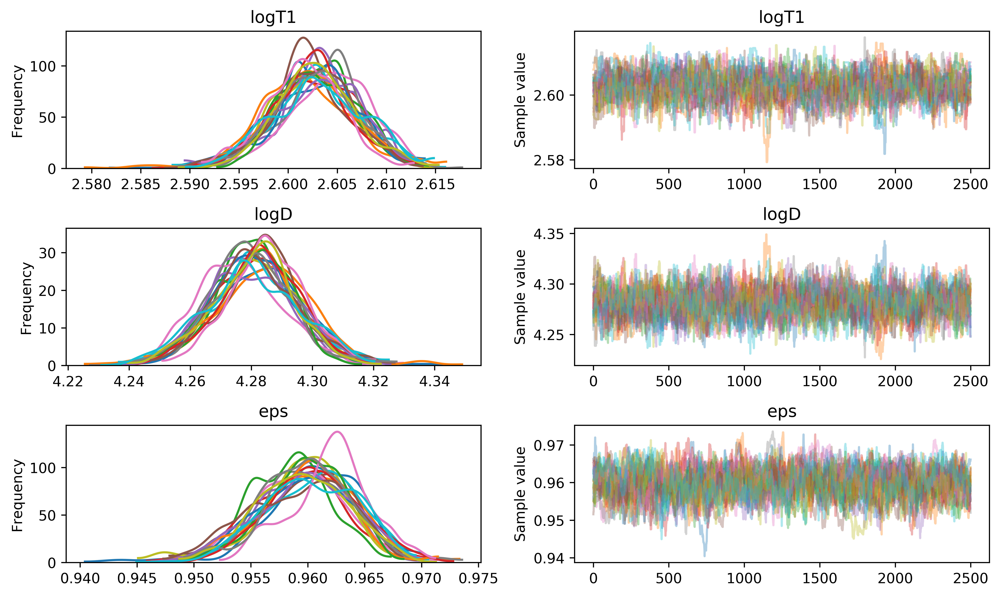

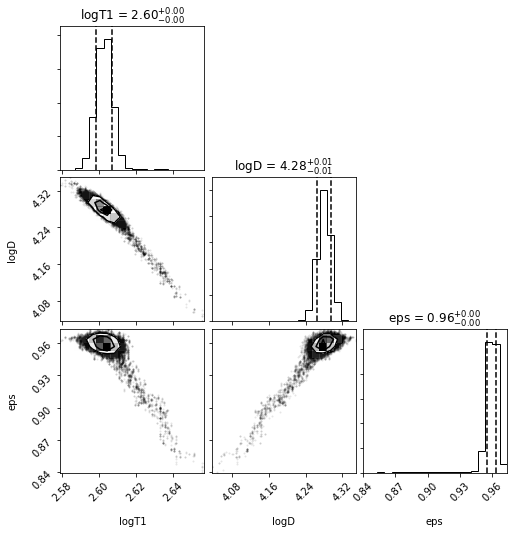

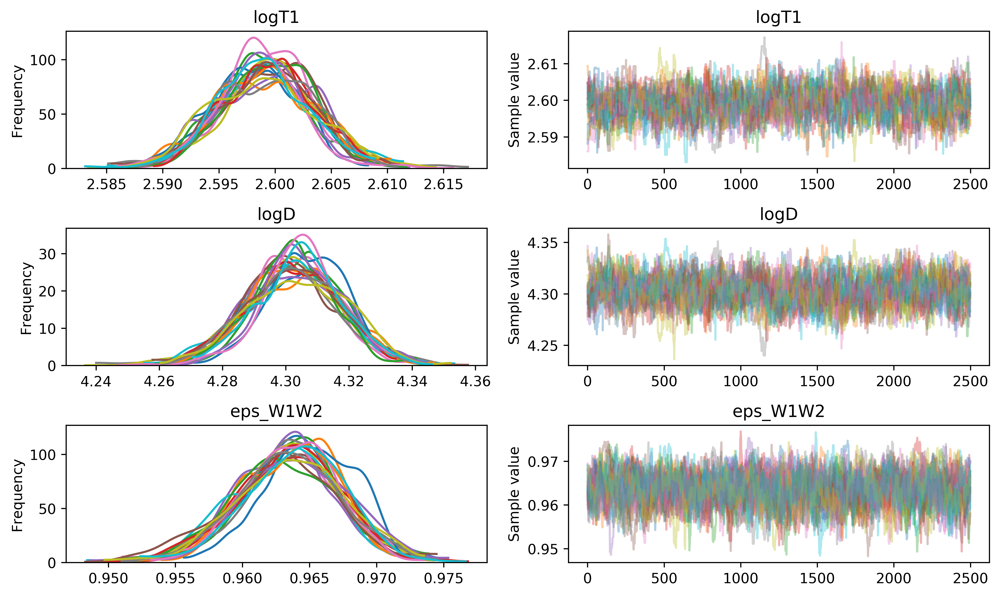

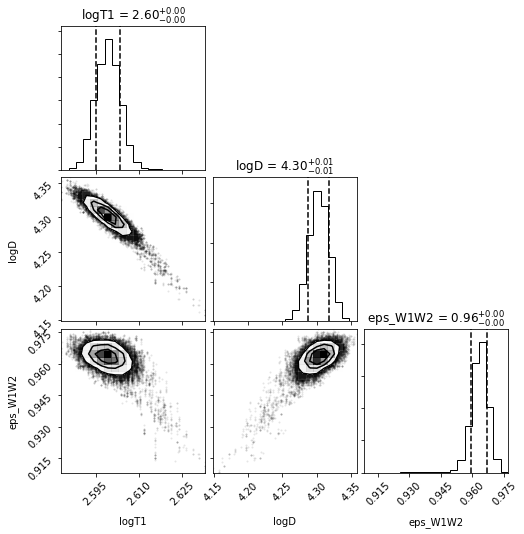

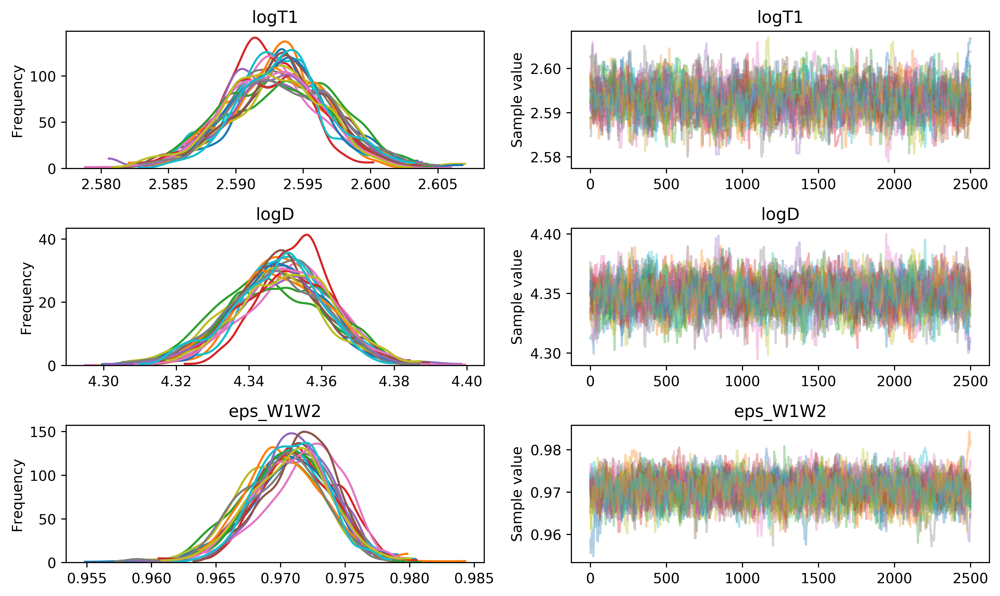

...

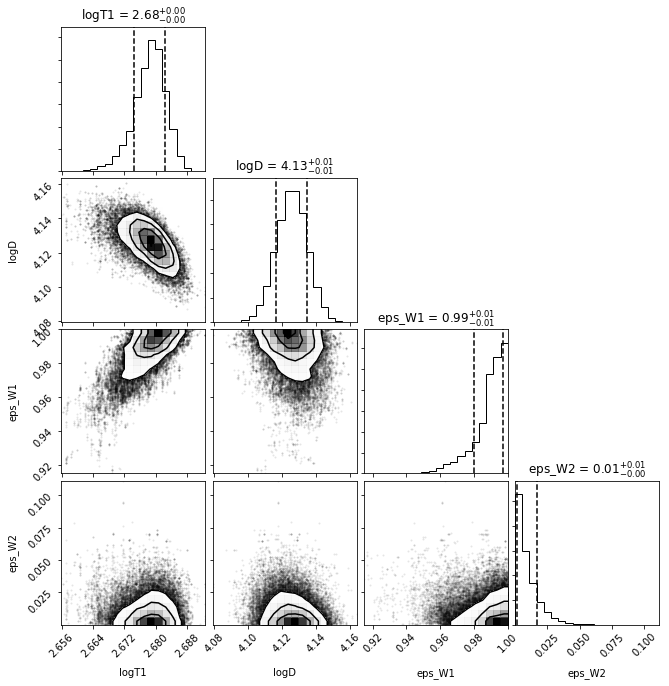

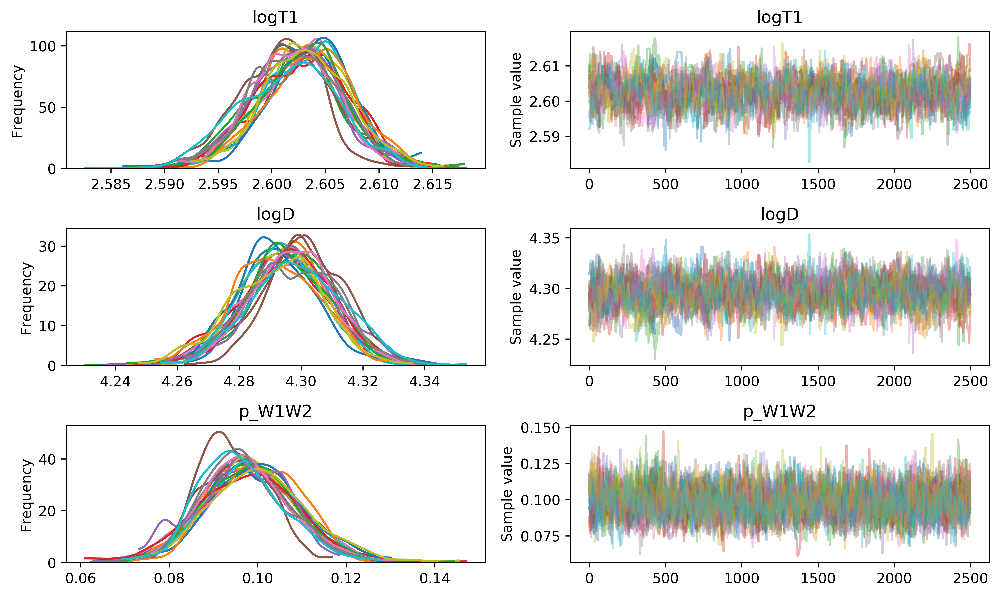

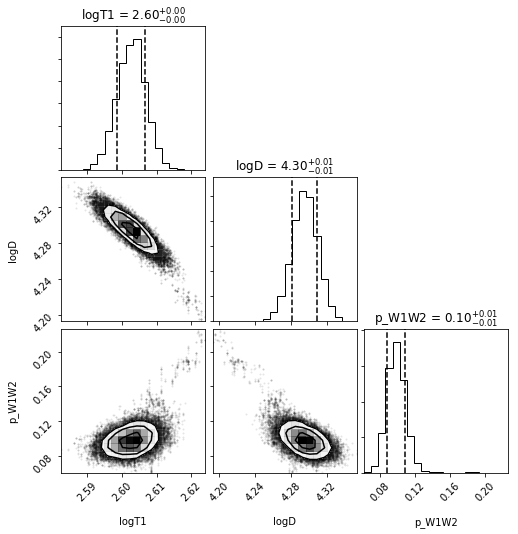

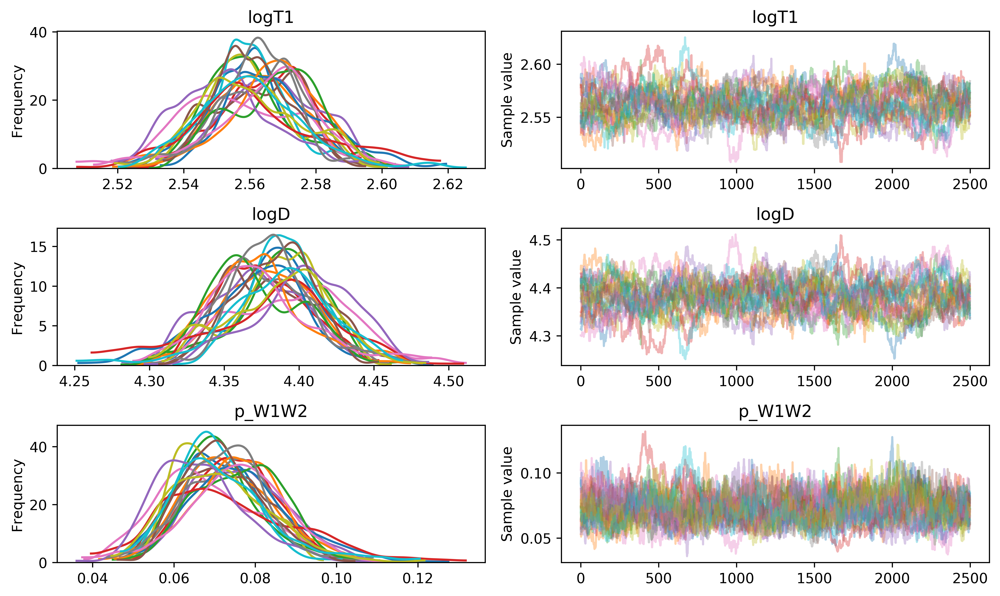

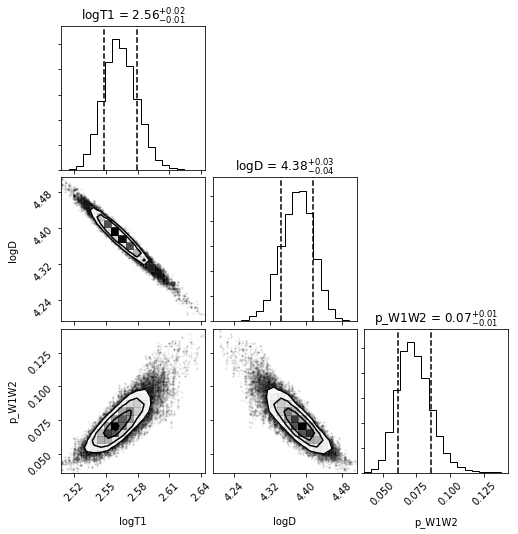

In [21]:
obs = WISE()
model = NEATM(verbose=False)

summary, model_observations = multiFit(model, obs, dataDict, runDict, fitConfig, 
                                       saveDir=asteroid_name)

In [22]:
summary

,designation,model,code,parameter,median,sigmaG,mean,sd,mc_error,n_eff,Rhat,hpd_2.5,hpd_97.5
0,1719,NEATM,run0,logT1,2.602717,0.004133,2.602651,0.004261,0.000137,493.490551,1.008403,2.594370e+00,2.610954
1,1719,NEATM,run0,logD,4.281335,0.013682,4.281144,0.013980,0.000462,411.759014,1.010792,4.253359e+00,4.308276
2,1719,NEATM,run0,eps,0.960022,0.004103,0.959838,0.004035,0.000159,295.410528,1.021593,9.518342e-01,0.967446
3,1719,NEATM,run1,logT1,2.599113,0.004189,2.599076,0.004167,0.000133,903.035594,1.005700,2.591040e+00,2.607099
4,1719,NEATM,run1,logD,4.303021,0.014130,4.302924,0.014217,0.000465,817.936957,1.006161,4.274251e+00,4.329870
5,1719,NEATM,run1,eps_W1W2,0.963668,0.003742,0.963529,0.003785,0.000111,822.845304,1.005162,9.559692e-01,0.970796
6,1719,NEATM,run2a,logT1,2.593153,0.003680,2.593104,0.003693,0.000103,1001.990232,1.010898,2.586066e+00,2.600637
7,1719,NEATM,run2a,logD,4.349115,0.012766,4.348855,0.012903,0.000379,817.402463,1.012200,4.323058e+00,4.373757
8,1719,NEATM,run2a,eps_W1W2,0.970871,0.003103,0.970739,0.003098,0.000090,685.706072,1.010443,9.647583e-01,0.976683
9,1719,NEATM,run2b,logT1,2.679742,0.002894,2.679607,0.002965,0.000116,190.647917,1.039810,2.673483e+00,2.685169


In [23]:
residuals, chi2 = calcMagChi2(obs, data, model_observations)

Calculating magitude residuals using these columns:
Observations : mag_W1, mag_W2, mag_W3, mag_W4
Model Predictions : model_mag_W1, model_mag_W2, model_mag_W3, model_mag_W4
Done.
Calculating chi squared using these columns:
Magnitude Residuals : residuals_W1, residuals_W2, residuals_W3, residuals_W4
Magnitude Errors : magErr_W1, magErr_W2, magErr_W3, magErr_W4
Done.


In [24]:
reduced_chi2 = calcMagReducedChi2(obs, chi2, data, summary)

Calculating reduced chi squared using these columns:
Chi squared : chi2_W1, chi2_W2, chi2_W3, chi2_W4
Done.


In [25]:
reduced_chi2

,code,reduced_chi2_W1,reduced_chi2_W2,reduced_chi2_W3,reduced_chi2_W4,total_reduced_chi2
designation,,,,,,
1719,run0,4.176189,2.109098,2.488646,3.482344,12.256278
1719,run1,4.183392,2.106422,2.473850,3.302225,12.065889
1719,run2a,4.273183,1.818775,2.935812,1.988766,11.016535
1719,run2b,3.967171,2.879153,4.171183,14.544624,25.562132
1719,run3a,4.244151,1.822227,2.857309,2.062942,10.986628
1719,run3b,4.150663,2.505628,3.435897,12.274155,22.366341
1719,run4a,4.238059,1.855192,2.782107,2.067270,10.942627
1719,run4b,4.308380,2.308032,3.137981,10.860288,20.614682
1719,run5a,4.161350,2.109694,2.490553,3.463428,12.225025


In [26]:
lambdaRange=[1.0e-6, 30e-6]
lambdaNum=250
lambdaEdges=[3.9e-6, 6.5e-6, 18.5e-6]

SEDs = {}
for code in runDict.keys():
    SEDs[code] = calcFluxLambdaSED(model, obs, dataDict[code], 
                                   summary=summary[summary["code"] == code], 
                                   fitParameters=runDict[code]["fitParameters"],
                                   emissivitySpecification=runDict[code]["emissivitySpecification"],
                                   albedoSpecification=runDict[code]["albedoSpecification"],
                                   columnMapping=runDict[code]["columnMapping"],
                                   lambdaRange=lambdaRange,
                                   lambdaNum=lambdaNum,
                                   lambdaEdges=lambdaEdges,
                                   linearInterpolation=False)

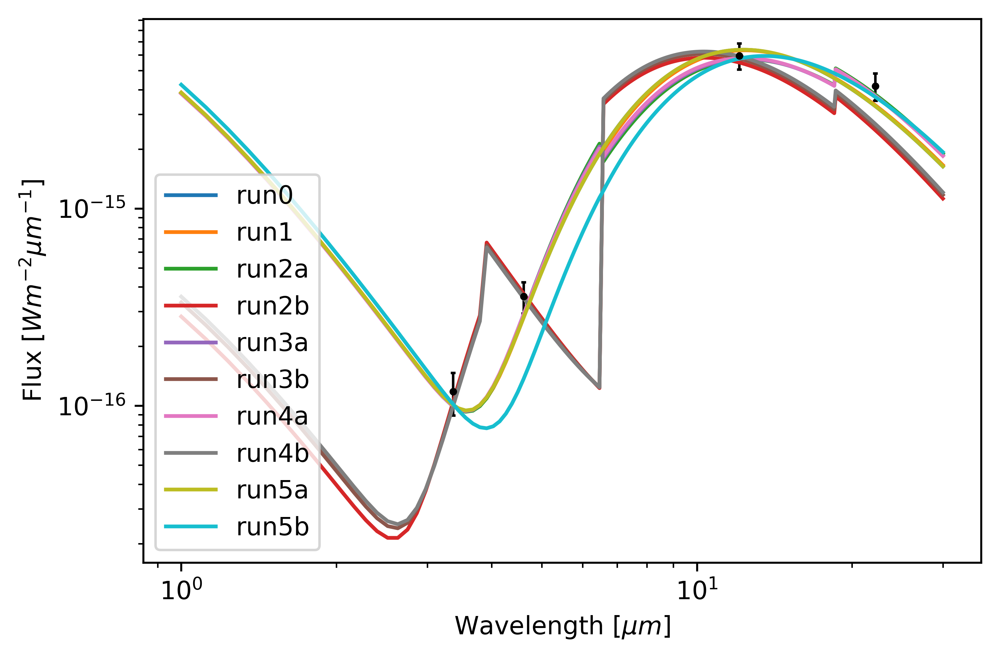

In [27]:
fig, ax = plt.subplots(1, 1, dpi=DPI)
plotObservations(obs, data, ax=ax, plotMedian=True)
for code in dataDict.keys():
    plotSED(SEDs[code], ax=ax, plotKwargs={"label": code})
ax.legend()

In [ ]:
# Interesting, 4 parameter models want to set eps_W2 to nearly 0.0